In [110]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import os
import glob
import pickle
from collections import OrderedDict


#loom
import loompy as lp
import umap
import json
import zlib
import base64
from MulticoreTSNE import MulticoreTSNE as TSNE
#scanpy
import scanpy as sc
import anndata as ad
#pyscenic
from arboreto.utils import load_tf_names
from arboreto.algo import grnboost2
from pyscenic.rnkdb import FeatherRankingDatabase as RankingDatabase
from pyscenic.utils import modules_from_adjacencies, load_motifs
from pyscenic.prune import prune2df, df2regulons
from pyscenic.aucell import aucell, derive_auc_threshold, create_rankings
from pyscenic.export import export2loom, add_scenic_metadata
from pyscenic.rss import regulon_specificity_scores
from pyscenic.plotting import plot_rss, plot_binarization
from adjustText import adjust_text
from pyscenic.binarization import binarize

In [4]:
sc.settings.njobs = 20
sc.settings.verbosity = 3        
sc.logging.print_header()
sc.set_figure_params(dpi=150, fontsize=10, dpi_save=600, frameon=False)

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.21.5 scipy==1.7.3 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.2 python-igraph==0.9.10 louvain==0.7.1 pynndescent==0.5.6


In [5]:
##### scanpy AnnData #####
# adata_path = '/tank/projects/omics2022/brain_project/pyscenic_res/anndata/ACC_anndata.h5ad'
# adata_path = '/tank/projects/omics2022/brain_project/pyscenic_res/anndata/ACC_anndata_human.h5ad'
adata_path = '/tank/projects/omics2022/brain_project/pyscenic_res/anndata/ACC_anndata_macaca.h5ad'
# adata = sc.read('/tank/projects/omics2022/brain_project/pyscenic_res/anndata/ACC_anndata.h5ad')
##### path to expression matrix #####
# expr_path = '/tank/projects/omics2022/brain_project/pyscenic_res/acc_all_species/expr_test.csv'
# expr_mtx = pd.read_csv(expr_path, index_col=0)
##### motifs annotation #####
motif_ann_path = '/tank/projects/omics2022/brain_project/motifs_annot/motifs-v9-nr.hgnc-m0.001-o0.0.tbl.txt'
##### transcription factors list #####
tf_list_path = '/tank/projects/omics2022/brain_project/TF_LISTS/hs_hgnc_curated_tfs.txt'
# tf_list = load_tf_names('/tank/projects/omics2022/brain_project/TF_LISTS/hs_hgnc_curated_tfs.txt')
##### cisTarget ranking databases #####
dbs_path = os.path.join('/tank/projects/omics2022/brain_project/pyscenic_databases/hg38_mc9nr_gene_base', "*.feather")
# db_fnames = glob.glob(dbs_path)
# dbs = [RankingDatabase(fname=fname, name=name(fname)) for fname in db_fnames]
##### output directory and prefix #####
output_dir = '/tank/projects/omics2022/brain_project/pyscenic_res/acc_macaca'
prefix = 'macaca'
##### number of cpu to use #####
num_workers = 25

# SCENIC pipeline

In [6]:
def name(fname):
    return os.path.splitext(os.path.basename(fname))[0]

In [7]:
def grn_shell(expr_path, tf_list_path, output_dir, prefix, num_workers):
    """ 
    Runs pyscenic grnboost2 and saves adjancencies in csv file
    
    :param expr_mtx: pd.DataFrame: Expression matrix cells - rows, genes - columns
    :param tf_list: list: Transcription factor list obtained via load_tf_names(tf_list_path)
    :param output_dir: str: Path to output directory
    :param prefix: str: Prefix to the file name 
    
    """
    
    
    import os
    import sys
    import subprocess
    
    if not os.path.isdir(output_dir):
        os.mkdir(output_dir)
        
    adj_out = os.path.join(output_dir, prefix+'_adj.csv')
    print(f"Running grnboost2")
    
    arboretro_path = '/home/bavanesyan/miniconda3/envs/pyscenic/bin/arboreto_with_multiprocessing.py'
    
    if os.path.isfile(expr_path) & os.path.isfile(tf_list_path):
        command = [arboretro_path, expr_path, tf_list_path,  '--method', 
                   'grnboost2', '--output', adj_out, '--num_workers', str(num_workers), '--seed', '777']
        arboretro_multiprocess = subprocess.run(command, text=True, check=True)
    elif os.path.isfile(expr_path):
        sys.stderr.write('Wrong path for expression matrix')
    elif os.path.isfile(tf_list_path):
        sys.stderr.write('Wrong path for TFs list')
    
    adj = pd.read_csv(adj_out)
    print(f"grnboost2 is done")
    return adj

In [6]:
def grn(expr_mtx, tf_list_path, output_dir, prefix):
    """ 
    Runs pyscenic grnboost2 and saves adjancencies in csv file
    
    :param expr_mtx: pd.DataFrame: Expression matrix cells - rows, genes - columns
    :param tf_list: list: Transcription factor list obtained via load_tf_names(tf_list_path)
    :param output_dir: str: Path to output directory
    :param prefix: str: Prefix to the file name 
    
    """
    
    
    import os
    
    if not os.path.isdir(output_dir):
        os.mkdir(output_dir)
        
    tf_list = load_tf_names(tf_list_path)
    
    adj_out = os.path.join(output_dir, prefix+'_adj.csv')
    print(f"Running grnboost2")
    adj = grnboost2(expression_data=expr_mtx, tf_names=tf_list, verbose=True)
    adj.to_csv(adj_out)
    print(f"grnboost2 is done")
    return adj

In [8]:
def predict_modules(adj, expr_mtx, output_dir, prefix):
    """
    Runs module_from_adjancensies and saves them in pickle file 
    
    :param adj: pd.DataFrame: adjancensies obtained via grnboost2
    :param tf_list: list: Transcription factor list obtained via load_tf_names(tf_list_path)
    :param output_dir: str: Path to output directory
    :param prefix: str: Prefix to the file name 
    
    """
    
    import os
    import glob
    import pickle
    
    if not os.path.isdir(output_dir):
        os.mkdir(output_dir)
    
    modules_out = os.path.join(output_dir, prefix+'_modules.p')
    print('Running modules_from_adjancesies')
    modules = list(modules_from_adjacencies(adjacencies=adj, ex_mtx=expr_mtx))
    with open(modules_out, 'wb') as f:
        pickle.dump(modules, f)
    print('modules_from_adjancesies is done')
    return modules

In [9]:
def predict_motifs(dbs_path, modules, motif_ann_path, num_workers, output_dir, prefix):
    """
    Runs prune2df and saves motif enrichment in csv file 
    
    :param dbs_path: str: Path to ranking databases
    :param modules: list: Modules generated by modules_from_adjancesies
    :param motif_ann_path: str: Path to file containing motif annotation
    :num_workers: str: Number of cpus to use
    :param output_dir: str: Path to output directory
    :param prefix: str: Prefix to the file name 
    
    """
    import os
    
    def name(fname):
        return os.path.splitext(os.path.basename(fname))[0]
    
    db_fnames = glob.glob(dbs_path)
    dbs = [RankingDatabase(fname=fname, name=name(fname)) for fname in db_fnames]
    
    if not os.path.isdir(output_dir):
        os.mkdir(output_dir)
        
    motifs_out = os.path.join(output_dir, prefix+'_motifs.csv')
    print('Running prune2df')
    motifs = prune2df(rnkdbs=dbs, modules=modules, motif_annotations_fname=motif_ann_path, num_workers=num_workers)
    motifs.to_csv(motifs_out)
    print('prune2df is done')
    return motifs

In [10]:
def derive_regulons(motifs, output_dir, prefix):
    """
    Selects only regulons that contains >= 10 genes, with NES>=0 and only directly annotated TFs or TF annotated 
    for an orthologous gene. Save the obtained regulons into a pickle file
    
    :param motifs: pd.DataFrame: Motifs obtained with prune2df function
    :param output_dir: str: Path to output directory
    :param prefix: str: Prefix to the file name 
    
    """
    import os
    import glob
    import pickle
    
    if not os.path.isdir(output_dir):
        os.mkdir(output_dir)
    
    motifs.columns = motifs.columns.droplevel(0)

    regulons = list(filter(lambda r: len(r) >= 10, df2regulons(motifs[(motifs['NES'] >= 3.0) 
                                                                      & ((motifs['Annotation'] == 'gene is directly annotated')
                                                                        | (motifs['Annotation'].str.startswith('gene is orthologous to')
                                                                           & motifs['Annotation'].str.endswith('which is directly annotated for motif')))
                                                                     ])))
    
    regulons = list(map(lambda r: r.rename(r.transcription_factor), regulons))

    with open(os.path.join(output_dir, prefix+'_regulons.p'), 'wb') as f:
        pickle.dump(regulons, f)
    
    return regulons

In [11]:
def derive_cell_enrichment(expr_mtx, regulons, num_workers, output_dir, prefix):
    """
    Runs aucell and save cell enrichment dataframe in csv file
    
    :param expr_mtx: pd.DataFrame: Expression matrix cells - rows, genes - columns
    :param regulons: list: Regulons obtained with derive_regulons function
    :num_workers: str: Number of cpus to use
    :param output_dir: str: Path to output directory
    :param prefix: str: Prefix to the file name 
    
    """
    
    import os
    
    if not os.path.isdir(output_dir):
        os.mkdir(output_dir)
    print('Running aucell')
    auc_out = os.path.join(output_dir, prefix+'_auc.csv')
    auc = aucell(exp_mtx=expr_mtx, signatures=regulons, num_workers=num_workers)
#     auc.columns = list(map(lambda x: x[:len(x)-3],auc.columns))
    auc.to_csv(auc_out)
    print('aucell is done')
    return auc

In [88]:
def derive_aucell_adata(adata, auc_mtx, output_dir, prefix, cats = ['Cell_type', 'Species', 'Louvain']):
    import os
    
    if not os.path.isdir(output_dir):
        os.mkdir(output_dir)
    
    aucell_adata_out = os.path.join(output_dir, prefix+'_aucell_adata.h5ad')
    
    aucell_adata = sc.AnnData(X=auc_mtx.sort_index())
    aucell_adata.obs = adata.obs[cats]
    aucell_adata.write(aucell_adata_out)
    
    return aucell_adata

In [16]:
def scenic_pipeline(adata_path, tf_list_path, dbs_path, motif_ann_path, output_dir, prefix, num_workers, expr_path=None):
    
    import scanpy as sc
    import os
    
    if not os.path.isdir(output_dir):
        os.mkdir(output_dir)
    
    print('Importing data')
    adata = sc.read(adata_path)
    expr_mtx = adata.to_df()
    if expr_path == None:
        print('Saving expression matrix')
        expr_path = os.path.join(output_dir, prefix+'_expr.csv')
        expr_mtx.to_csv(expr_path)
    print('Import done')
    
    adj = grn_shell(expr_path=expr_path, tf_list_path=tf_list_path, output_dir=output_dir, 
                    prefix=prefix, num_workers=num_workers)
    modules = predict_modules(adj=adj, expr_mtx=expr_mtx,output_dir=output_dir, prefix=prefix)
    motifs = predict_motifs(dbs_path=dbs_path, modules=modules, motif_ann_path=motif_ann_path,num_workers=num_workers,
                               output_dir=output_dir, prefix=prefix)
    regulons = derive_regulons(motifs=motifs, output_dir=output_dir, prefix=prefix)
    auc = derive_cell_enrichment(expr_mtx=expr_mtx, regulons=regulons, num_workers=num_workers,
                                 output_dir=output_dir, prefix=prefix)
    print('Updating anndata')
    adata_scenic = add_scenic_metadata(adata=adata, auc_mtx=auc, regulons=regulons, bin_rep=True, copy=True)
    adata_scenic_out = os.path.join(output_dir, prefix+'_adata_scenic.h5ad')
    adata_scenic.write(adata_scenic_out)

In [14]:
scenic_pipeline(adata_path=adata_path, tf_list_path=tf_list_path, 
                dbs_path=dbs_path, motif_ann_path=motif_ann_path,
                output_dir=output_dir, prefix=prefix, num_workers=num_workers)

Importing data
Saving expression matrix
Import done
Running grnboost2


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


Loaded expression matrix of 4843 cells and 1999 genes in 1.706860065460205 seconds...
Loaded 1390 TFs...
starting grnboost2 using 25 processes...


100%|██████████| 1999/1999 [06:05<00:00,  5.47it/s]


Done in 366.27563071250916 seconds.



2022-05-11 21:34:02,880 - pyscenic.utils - INFO - Calculating Pearson correlations.

2022-05-11 21:34:02,914 - pyscenic.utils - WARNING - Note on correlation calculation: the default behaviour for calculating the correlations has changed after pySCENIC verion 0.9.16. Previously, the default was to calculate the correlation between a TF and target gene using only cells with non-zero expression values (mask_dropouts=True). The current default is now to use all cells to match the behavior of the R verision of SCENIC. The original settings can be retained by setting 'rho_mask_dropouts=True' in the modules_from_adjacencies function, or '--mask_dropouts' from the CLI.
	Dropout masking is currently set to [False].


grnboost2 is done
Running modules_from_adjancesies



2022-05-11 21:34:04,576 - pyscenic.utils - INFO - Creating modules.


modules_from_adjancesies is done
Running prune2df


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


prune2df is done
Create regulons from a dataframe of enriched features.
Additional columns saved: []
Running aucell
aucell is done


NameError: name 'auc' is not defined

# Plots

## RSS

In [17]:
def calculate_rss(auc_mtx, adata, cat_name):
    rss = regulon_specificity_scores(auc_mtx, adata.obs[f'{cat_name}'])
    return rss

In [18]:
def derive_categories(adata, cat_name):
    cats = sorted(list(set(adata.obs[f'{cat_name}'])))
    return cats

In [19]:
def rss_panel_plot(cats,rss, figsize:tuple = (15,8)):


    fig = plt.figure(figsize=figsize)
    
    if len(cats) == 1:
        nrows, ncols = 1, 1
    elif 1<len(cats)<=4:
        nrows, ncols = 1, len(cats)
    elif (len(cats)>4) & (len(cats) % 4 == 0):
        nrows, ncols = len(cats) // 4, 4
    elif (len(cats)>4) & (len(cats) % 4 != 0):
        nrows, ncols = len(cats) // 4 + 1, 4
    else:
        print('Number of cell types should be a positive integer')
    
    for c,index in zip(cats, range(1,len(cats)+1)):
        x=rss.T[c]
        ax = fig.add_subplot(nrows,ncols,index)
        plot_rss(rss, c, top_n=5, max_n=None, ax=ax)
        ax.set_ylim( x.min()-(x.max()-x.min())*0.05 , x.max()+(x.max()-x.min())*0.05 )
        for t in ax.texts:
            t.set_fontsize(12)
        ax.set_ylabel('')
        ax.set_xlabel('')
        adjust_text(ax.texts, autoalign='xy', ha='right', va='bottom', arrowprops=dict(arrowstyle='-',color='green'), precision=0.001 )

    fig.text(0.5, 0.0, 'Regulon', ha='center', va='center', size='x-large')
    fig.text(0.00, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center', rotation='vertical', size='x-large')
    plt.tight_layout()
    plt.rcParams.update({
        'figure.autolayout': True,
            'figure.titlesize': 'large' ,
            'axes.labelsize': 'medium',
            'axes.titlesize':'large',
            'xtick.labelsize':'medium',
            'ytick.labelsize':'medium'
            })
    # plt.savefig("PBMC10k_cellType-RSS-top5.pdf", dpi=600, bbox_inches = "tight")
    plt.show()

## Heatmap

In [20]:
def derive_topreg(cats, rss, ntops):
    topreg = {}
    for i in cats:
        topreg[i] = list(rss.loc[i].sort_values(ascending=False)[:ntops].index)
    return topreg

In [21]:
def derive_topreg_list(cats, rss, topregs):
        topreg = []
        for i,c in enumerate(cats):
            topreg.extend(list(rss.T[c].sort_values(ascending=False)[:topregs].index))
        topreg = list(set(topreg))
        return topreg

In [22]:
def auc_z_score(auc_mtx):
    auc_mtx_Z = pd.DataFrame( index=auc_mtx.index )
    for col in list(auc_mtx.columns):
        auc_mtx_Z[ col ] = ( auc_mtx[col] - auc_mtx[col].mean()) / auc_mtx[col].std(ddof=0)
    return auc_mtx_Z

In [23]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    plt.show()
    return f

In [24]:
def generate_palette(adata, cats, cat_name, palette = 'brigth'):
    colors = sns.color_palette('bright',n_colors=len(cats))
    colorsd = dict(zip(cats, colors))
    colormap = [colorsd[x] for x in adata.obs[cat_name]]
    palplot(pal=colors, names=cats, size=1.0)
    return colormap

In [25]:
def heatmap(adata, auc_mtx, rss, cat_name, topregs=5, figsize=(20,15)):
    
    def hex_to_rgb(value):
        '''
        Converts hex to rgb colours
        value: string of 6 characters representing a hex colour.
        Returns: list length 3 of RGB values'''
        value = value.strip("#") # removes hash symbol if present
        lv = len(value)
        return tuple(int(value[i:i + lv // 3], 16) for i in range(0, lv, lv // 3))


    def rgb_to_dec(value):
        '''
        Converts rgb to decimal colours (i.e. divides each value by 256)
        value: list (length 3) of RGB values
        Returns: list (length 3) of decimal values'''
        return [v/256 for v in value]
    
    def get_continuous_cmap(hex_list, float_list=None):
        ''' 
        creates and returns a color map that can be used in heat map figures.
        If float_list is not provided, colour map graduates linearly between each color in hex_list.
        If float_list is provided, each color in hex_list is mapped to the respective location in float_list. 
        
        Parameters
        ----------
        hex_list: list of hex code strings
        float_list: list of floats between 0 and 1, same length as hex_list. Must start with 0 and end with 1.
        
        Returns
        ----------
        colour map'''
    
        import matplotlib.colors as mcolors

        rgb_list = [rgb_to_dec(hex_to_rgb(i)) for i in hex_list]
        if float_list:
            pass
        else:
            float_list = list(np.linspace(0,1,len(rgb_list)))

        cdict = dict()
        for num, col in enumerate(['red', 'green', 'blue']):
            col_list = [[float_list[i], rgb_list[i][num], rgb_list[i][num]] for i in range(len(float_list))]
            cdict[col] = col_list
        cmp = mcolors.LinearSegmentedColormap('my_cmp', segmentdata=cdict, N=256)
        return cmp
    
    
    def derive_topreg_list(cats, rss, topregs):
        topreg = []
        for i,c in enumerate(cats):
            topreg.extend(list(rss.T[c].sort_values(ascending=False)[:topregs].index))
        topreg = list(set(topreg))
        return topreg
    
    def palplot(pal, names, colors=None, size=1):
        n = len(pal)
        f, ax = plt.subplots(1, 1, figsize=(n * size, size))
        ax.imshow(np.arange(n).reshape(1, n),
                  cmap=mpl.colors.ListedColormap(list(pal)),
                  interpolation="nearest", aspect="auto")
        ax.set_xticks(np.arange(n) - .5)
        ax.set_yticks([-.5, .5])
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        colors = n * ['k'] if colors is None else colors
        for idx, (name, color) in enumerate(zip(names, colors)):
            ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
        return f
    
    def generate_palette(adata, cats, cat_name, palette = 'brigth'):
        sns.set()
        sns.set(font_scale=0.8)
        colors = sns.color_palette('bright',n_colors=len(cats))
        colorsd = dict(zip(cats, colors))
        colormap = [colorsd[x] for x in adata.obs[cat_name]]
        palplot(pal=colors, names=cats, size=1.0)
        return colormap
    
    def auc_z_score(auc_mtx):
        auc_mtx_Z = pd.DataFrame( index=auc_mtx.index )
        for col in list(auc_mtx.columns):
            auc_mtx_Z[ col ] = ( auc_mtx[col] - auc_mtx[col].mean()) / auc_mtx[col].std(ddof=0)
        return auc_mtx_Z
    
    import seaborn as sns
    
    cats = derive_categories(adata=adata, cat_name=cat_name)
    topreg = derive_topreg_list(cats = cats, rss = rss, topregs=topregs)
    auc_mtx_Z = auc_z_score(auc_mtx=auc_mtx)
    
    hex_list = ['#0000FF', '#B6B6B4', '#ED2939']
    cmap = get_continuous_cmap(hex_list)
    
    colormap = generate_palette(adata=adata, cats=cats, cat_name=cat_name)
    
    sns.set()
    sns.set(font_scale=1.0)
    g = sns.clustermap(auc_mtx_Z[topreg], annot=False,  square=False,  linecolor='gray',
        yticklabels=False, xticklabels=True, vmin=-2, vmax=6, row_colors=colormap,
        cmap="YlGnBu", figsize=figsize)
    g.cax.set_visible(True)
    g.ax_heatmap.set_ylabel('')
    g.ax_heatmap.set_xlabel('')
    plt.show()

## AUC distribution

In [26]:
def auc_dist(regulon_list, auc_mtx, auc_thresholds, figsize = (15,15)):
    
    
    fig = plt.figure(figsize=figsize)
    
    if len(regulon_list) == 1:
        nrows, ncols = 1, 1
    elif 1<len(regulon_list)<=4:
        nrows, ncols = 1, len(regulon_list)
    elif (len(regulon_list)>4) & (len(regulon_list) % 4 == 0):
        nrows, ncols = len(regulon_list) // 4, 4
    elif (len(regulon_list)>4) & (len(regulon_list) % 4 != 0):
        nrows, ncols = len(regulon_list) // 4 + 1, 4
    else:
        print('Number of cell types should be a positive integer')
    
    for i in range(len(regulon_list)):
        ax = fig.add_subplot(nrows,ncols,i+1)
        sns.histplot(auc_mtx[regulon_list[i]], kde=True, ax=ax,)
        ax.plot([auc_thresholds[regulon_list[i]]]*2, ax.get_ylim(), 'r:')
        ax.title.set_text(regulon_list[i])
#         ax.set_ylim()
#         plt.ylim(top=auc_mtx[regulon_list[i]].value_counts().values[1]+5)
        ax.set_xlabel('')
        ax.set_ylabel('')
    
    
    fig.text(-0.01, 0.5, 'Frequency', ha='center', va='center', rotation='vertical', size='large')
    fig.text(0.5, -0.01, 'AUC', ha='center', va='center', rotation='horizontal', size='large')

    fig.tight_layout()
    plt.show()

## cmap

In [27]:
def hex_to_rgb(value):
    '''
    Converts hex to rgb colours
    value: string of 6 characters representing a hex colour.
    Returns: list length 3 of RGB values'''
    value = value.strip("#") # removes hash symbol if present
    lv = len(value)
    return tuple(int(value[i:i + lv // 3], 16) for i in range(0, lv, lv // 3))


def rgb_to_dec(value):
    '''
    Converts rgb to decimal colours (i.e. divides each value by 256)
    value: list (length 3) of RGB values
    Returns: list (length 3) of decimal values'''
    return [v/256 for v in value]

In [28]:
def get_continuous_cmap(hex_list, float_list=None):
    ''' creates and returns a color map that can be used in heat map figures.
        If float_list is not provided, colour map graduates linearly between each color in hex_list.
        If float_list is provided, each color in hex_list is mapped to the respective location in float_list. 
        
        Parameters
        ----------
        hex_list: list of hex code strings
        float_list: list of floats between 0 and 1, same length as hex_list. Must start with 0 and end with 1.
        
        Returns
        ----------
        colour map'''
    
    import matplotlib.colors as mcolors
    
    rgb_list = [rgb_to_dec(hex_to_rgb(i)) for i in hex_list]
    if float_list:
        pass
    else:
        float_list = list(np.linspace(0,1,len(rgb_list)))
        
    cdict = dict()
    for num, col in enumerate(['red', 'green', 'blue']):
        col_list = [[float_list[i], rgb_list[i][num], rgb_list[i][num]] for i in range(len(float_list))]
        cdict[col] = col_list
    cmp = mcolors.LinearSegmentedColormap('my_cmp', segmentdata=cdict, N=256)
    return cmp

In [341]:
hex_list = ['#0000FF', '#B6B6B4', '#ED2939']

In [342]:
cmap = get_continuous_cmap(hex_list)

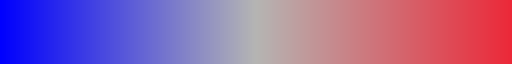

In [343]:
cmap

# Graphical analysis

## All species

In [81]:
adata_all_sp = sc.read('/tank/projects/omics2022/brain_project/pyscenic_res/acc_all_species/all_species_adata_scenic.h5ad')

In [92]:
adata_all_sp

AnnData object with n_obs × n_vars = 14440 × 1999
    obs: 'Cell_type', 'Species', 'Louvain', 'Regulon(DLX1)', 'Regulon(FOS)', 'Regulon(IRF8)', 'Regulon(MEIS3)', 'Regulon(NR3C1)', 'Regulon(SOX2)', 'Regulon(SOX4)', 'Regulon(SOX6)'
    var: 'Regulon(DLX1)', 'Regulon(FOS)', 'Regulon(IRF8)', 'Regulon(MEIS3)', 'Regulon(NR3C1)', 'Regulon(SOX2)', 'Regulon(SOX4)', 'Regulon(SOX6)'
    uns: 'Cell_type_colors', 'Species_colors', 'aucell', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'rank_genes_groups', 'tsne', 'umap'
    obsm: 'X_aucell', 'X_aucell_bin', 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

/home/bavanesyan/miniconda3/envs/pyscenic/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


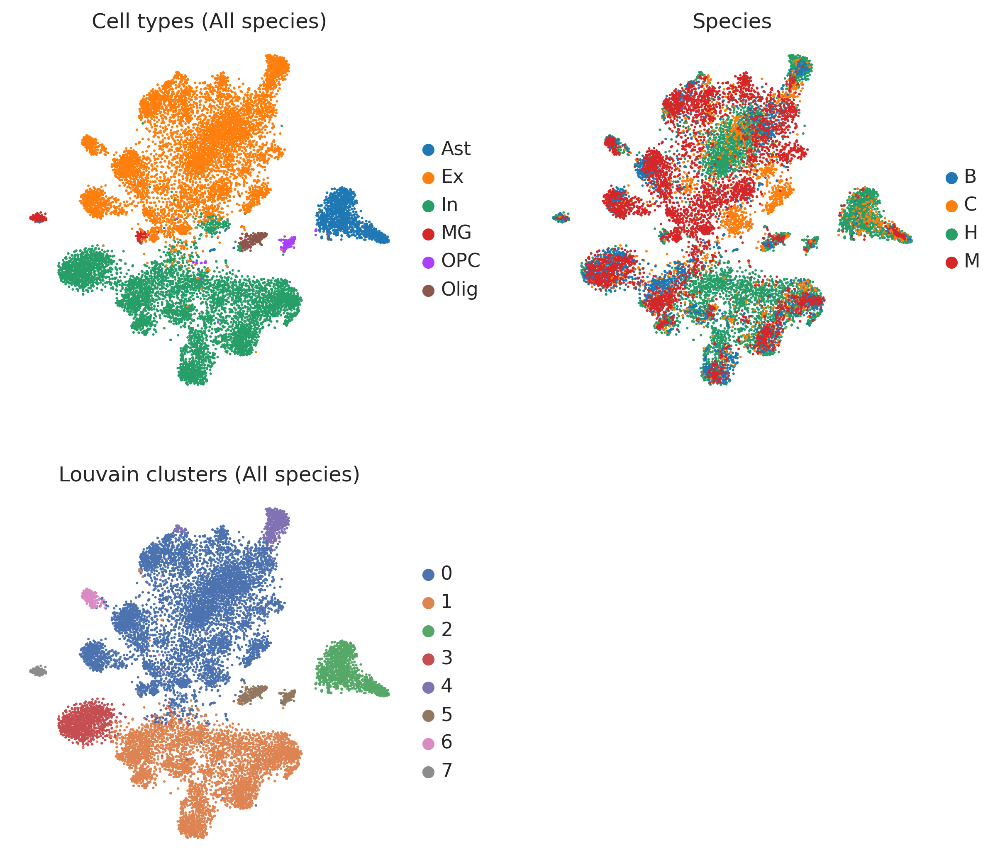

In [82]:
sc.pl.tsne(adata_all_sp, color=['Cell_type','Species', 'Louvain'], ncols=2,
          title=['Cell types (All species)', 'Species', 'Louvain clusters (All species)'])

In [105]:
auc_all_sp = pd.read_csv('/tank/projects/omics2022/brain_project/pyscenic_res/acc_all_species/all_species_auc.csv', index_col=0)
aucell_adata_all_sp = sc.AnnData(X=auc_all_sp.sort_index())
aucell_adata_all_sp.obs = adata_all_sp.obs[['Cell_type', 'Species', 'Louvain']]

/home/bavanesyan/miniconda3/envs/pyscenic/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  


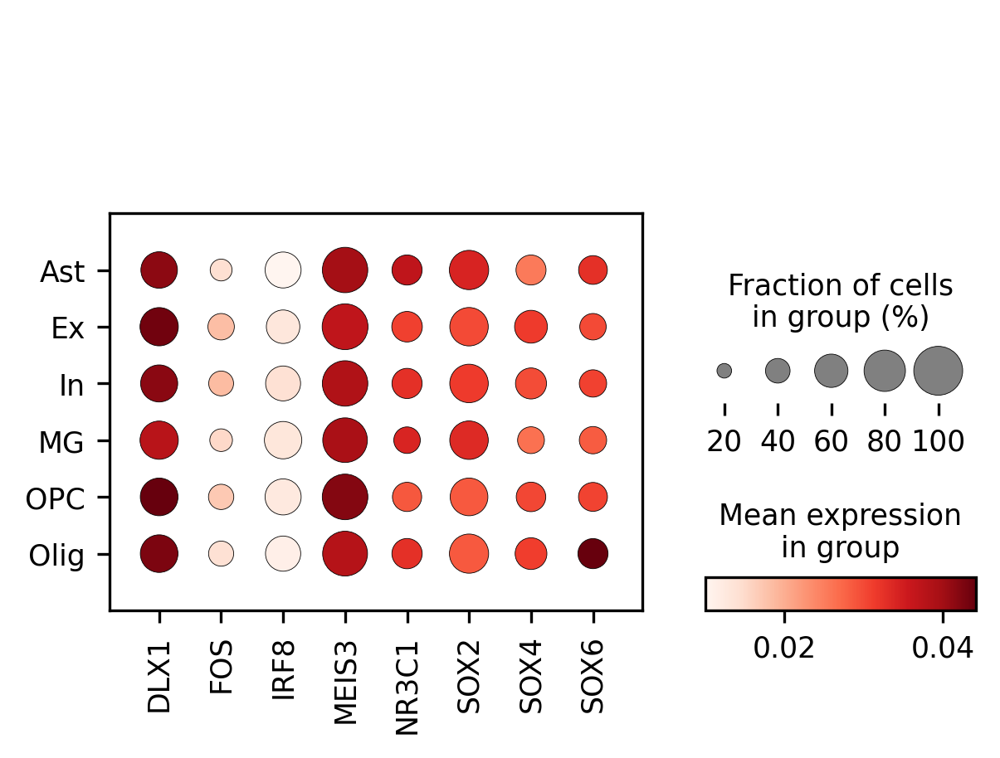

In [108]:
sc.pl.dotplot(aucell_adata_all_sp, auc_all_sp.columns, groupby='Cell_type')

## Human

In [101]:
adata_human = sc.read('/tank/projects/omics2022/brain_project/pyscenic_res/acc_human/human_adata_scenic.h5ad')
aucell_adata_human = sc.read('/tank/projects/omics2022/brain_project/pyscenic_res/acc_human/human_aucell_adata.h5ad')
auc_human = pd.read_csv('/tank/projects/omics2022/brain_project/pyscenic_res/acc_human/human_auc.csv', index_col=0)
rss_human_cell_type = calculate_rss(auc_mtx=auc_human, adata=adata_human, cat_name = 'Cell_type')
rss_human_louvain = calculate_rss(auc_mtx=auc_human, adata=adata_human, cat_name = 'Louvain')
cell_types_human = derive_categories(adata=adata_human, cat_name='Cell_type')
louvain_cls_human = derive_categories(adata=adata_human, cat_name='Louvain')
topreg_human_cell_types_human = derive_topreg(cats=cell_types_human, rss = rss_human_cell_type, ntops=5)
topreg_human_louvain = derive_topreg(cats=louvain_cls_human, rss = rss_human_louvain, ntops=5)
binary_mtx_human, auc_human_thresholds = binarize(auc_human, num_workers=25)
with open('/tank/projects/omics2022/brain_project/pyscenic_res/acc_human/human_regulons.p', 'rb') as f:
        regulons_human = pickle.load(f)

In [59]:
adata_human.obs.Cell_type.value_counts()

In      2437
Ex      1662
Ast      863
Olig     123
OPC      118
MG       111
Name: Cell_type, dtype: int64

In [67]:
adata_human.obs.Cell_type.value_counts().apply(lambda x: ((x / adata_human.obs.Cell_type.value_counts().sum()) * 100))

In      45.859992
Ex      31.275875
Ast     16.240120
Olig     2.314641
OPC      2.220549
MG       2.088822
Name: Cell_type, dtype: float64

2
4


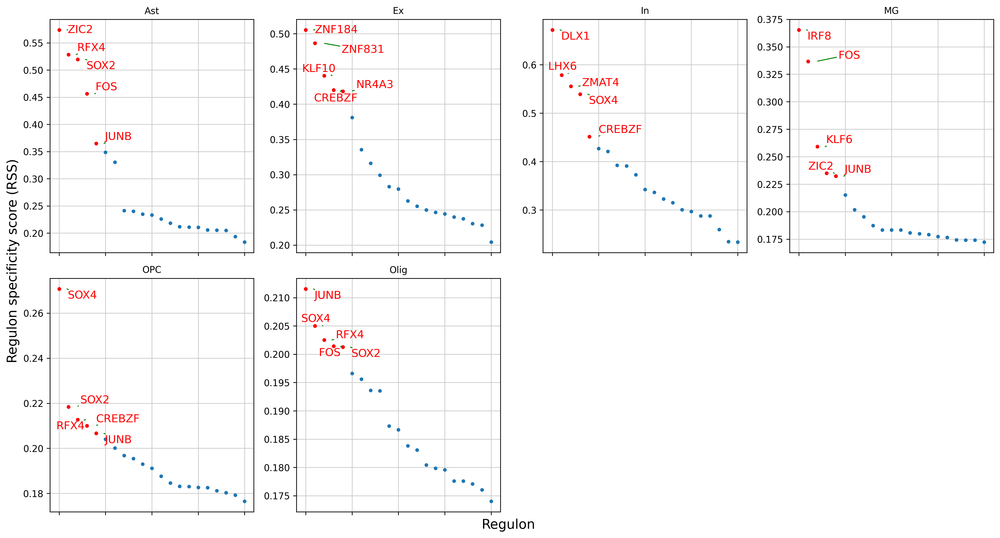

In [163]:
rss_panel_plot(cats=cell_types, rss=rss_human_cell_type)

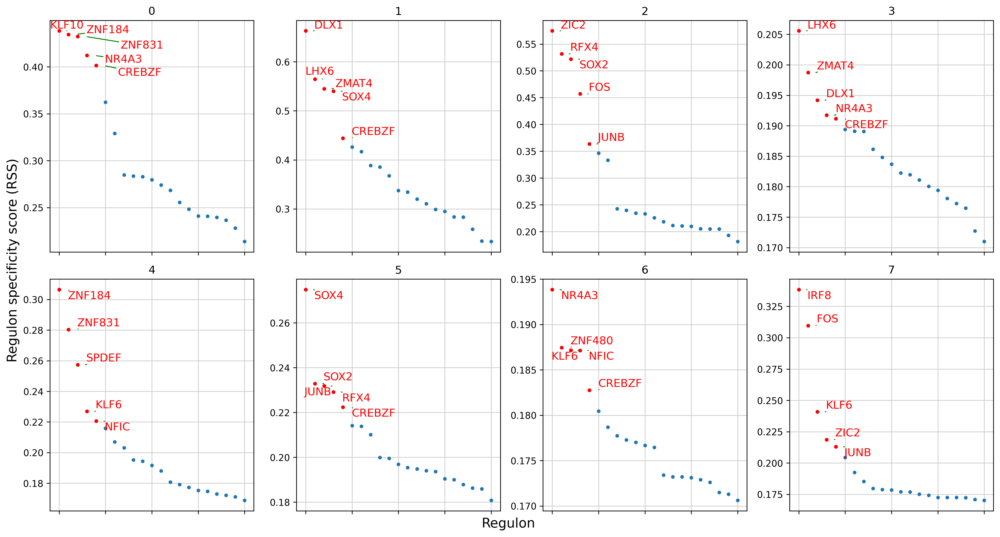

In [186]:
rss_panel_plot(cats=louvain_cls, rss=rss_human_louvain)

In [237]:
topreg_human_cell_types

{'Ast': ['ZIC2', 'RFX4', 'SOX2', 'FOS', 'JUNB'],
 'Ex': ['ZNF184', 'ZNF831', 'KLF10', 'CREBZF', 'NR4A3'],
 'In': ['DLX1', 'LHX6', 'ZMAT4', 'SOX4', 'CREBZF'],
 'MG': ['IRF8', 'FOS', 'KLF6', 'ZIC2', 'JUNB'],
 'OPC': ['SOX4', 'SOX2', 'RFX4', 'CREBZF', 'JUNB'],
 'Olig': ['JUNB', 'SOX4', 'RFX4', 'FOS', 'SOX2']}

In [185]:
topreg_human_louvain

{'0': ['KLF10', 'ZNF184', 'ZNF831', 'NR4A3', 'CREBZF'],
 '1': ['DLX1', 'LHX6', 'ZMAT4', 'SOX4', 'CREBZF'],
 '2': ['ZIC2', 'RFX4', 'SOX2', 'FOS', 'JUNB'],
 '3': ['LHX6', 'ZMAT4', 'DLX1', 'NR4A3', 'CREBZF'],
 '4': ['ZNF184', 'ZNF831', 'SPDEF', 'KLF6', 'NFIC'],
 '5': ['SOX4', 'SOX2', 'JUNB', 'RFX4', 'CREBZF'],
 '6': ['NR4A3', 'ZNF480', 'KLF6', 'NFIC', 'CREBZF'],
 '7': ['IRF8', 'FOS', 'KLF6', 'ZIC2', 'JUNB']}

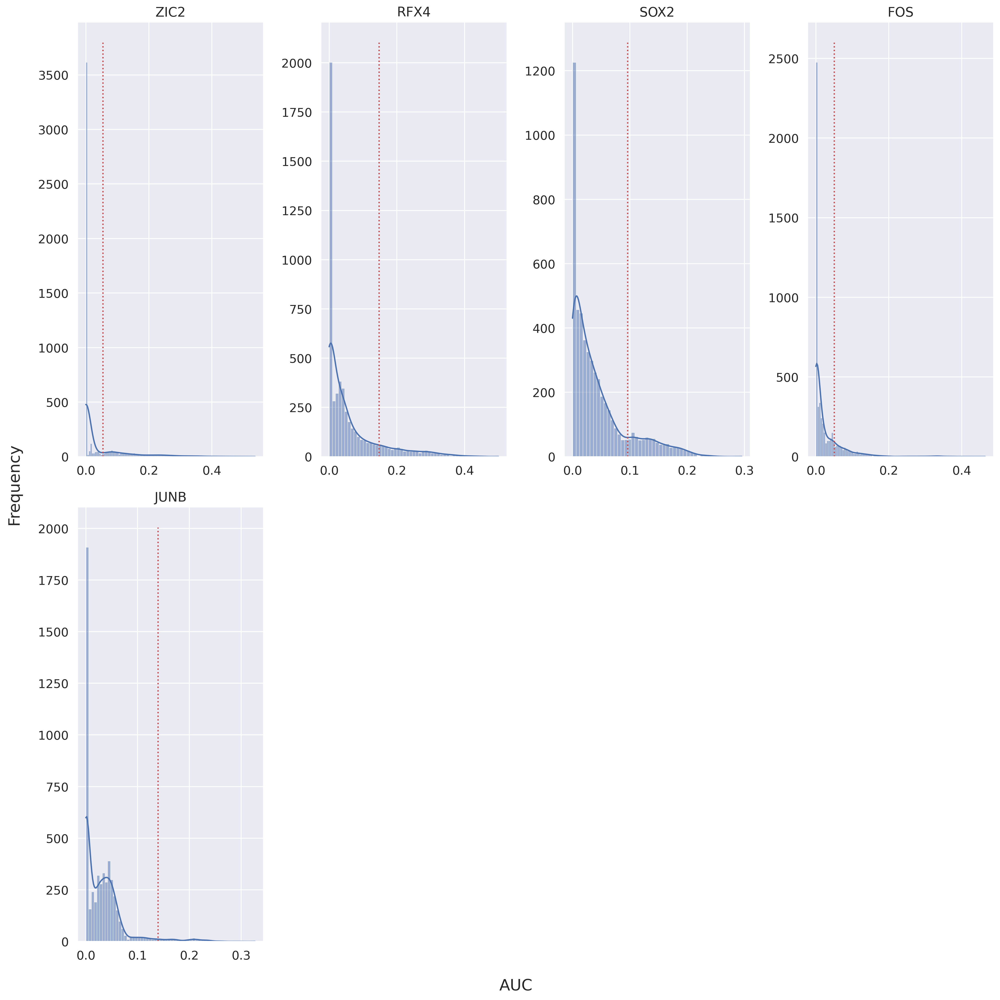

In [298]:
auc_dist(topreg_human_cell_types['Ast'], auc_human, auc_human_thresholds)

In [236]:
adata_human.var.index[adata_human.var['Regulon(JUNB)']]

Index(['ATF3', 'BTG2', 'FN1', 'FOS', 'CENPE', 'CARTPT', 'ENG', 'RCSD1', 'CHGB',
       'POP4', 'ZIC4', 'CCL4'],
      dtype='object', name='Gene')

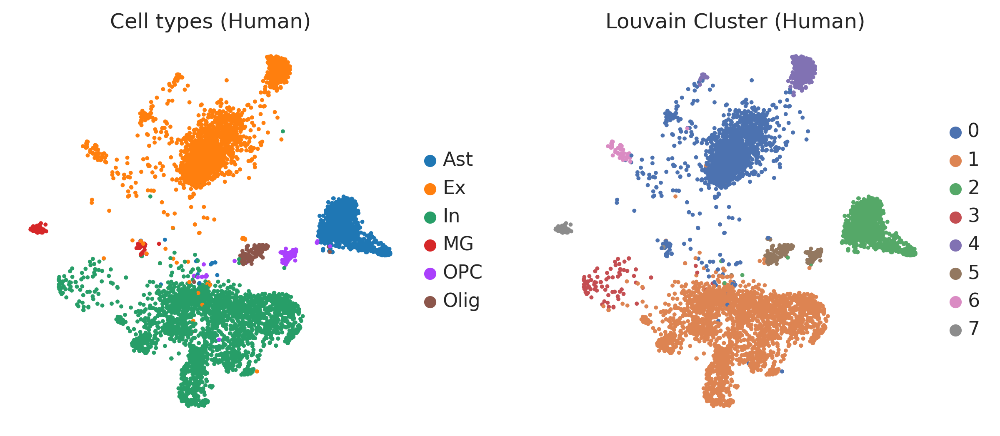

In [69]:
sc.pl.tsne(adata_human, color=['Cell_type', 'Louvain'], ncols=4, 
           title = ['Cell types (Human)', 'Louvain Cluster (Human)'])

In [350]:
topreg_human_cell_types

{'Ast': ['ZIC2', 'RFX4', 'SOX2', 'FOS', 'JUNB'],
 'Ex': ['ZNF184', 'ZNF831', 'KLF10', 'CREBZF', 'NR4A3'],
 'In': ['DLX1', 'LHX6', 'ZMAT4', 'SOX4', 'CREBZF'],
 'MG': ['IRF8', 'FOS', 'KLF6', 'ZIC2', 'JUNB'],
 'OPC': ['SOX4', 'SOX2', 'RFX4', 'CREBZF', 'JUNB'],
 'Olig': ['JUNB', 'SOX4', 'RFX4', 'FOS', 'SOX2']}

/home/bavanesyan/miniconda3/envs/pyscenic/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


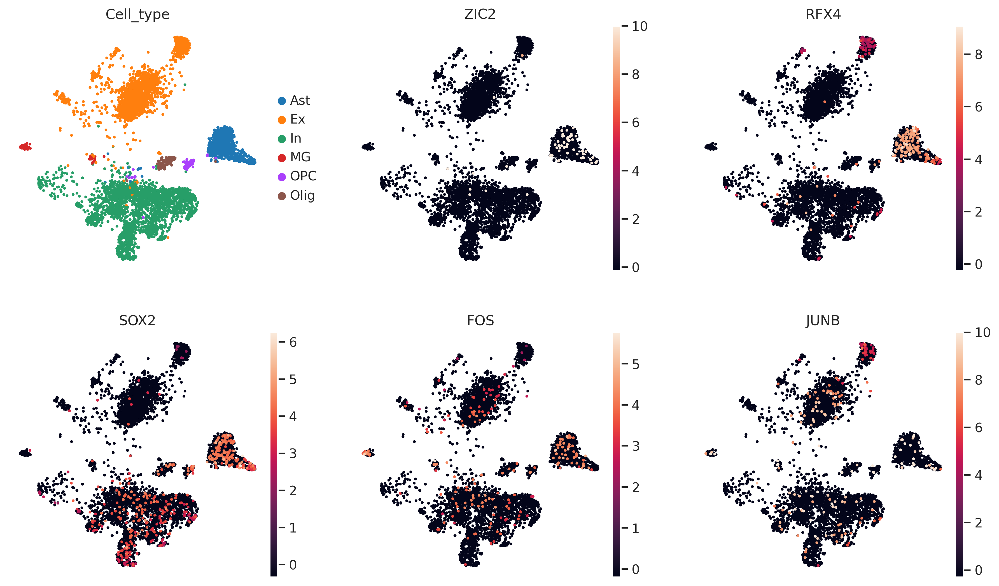

In [358]:
sc.pl.tsne(adata_human, color=['Cell_type', 'ZIC2', 'RFX4', 'SOX2', 'FOS', 'JUNB'], ncols=3)

In [356]:
list(map(lambda x: f'Regulon({x})',topreg_human_cell_types['Ast']))

['Regulon(ZIC2)',
 'Regulon(RFX4)',
 'Regulon(SOX2)',
 'Regulon(FOS)',
 'Regulon(JUNB)']

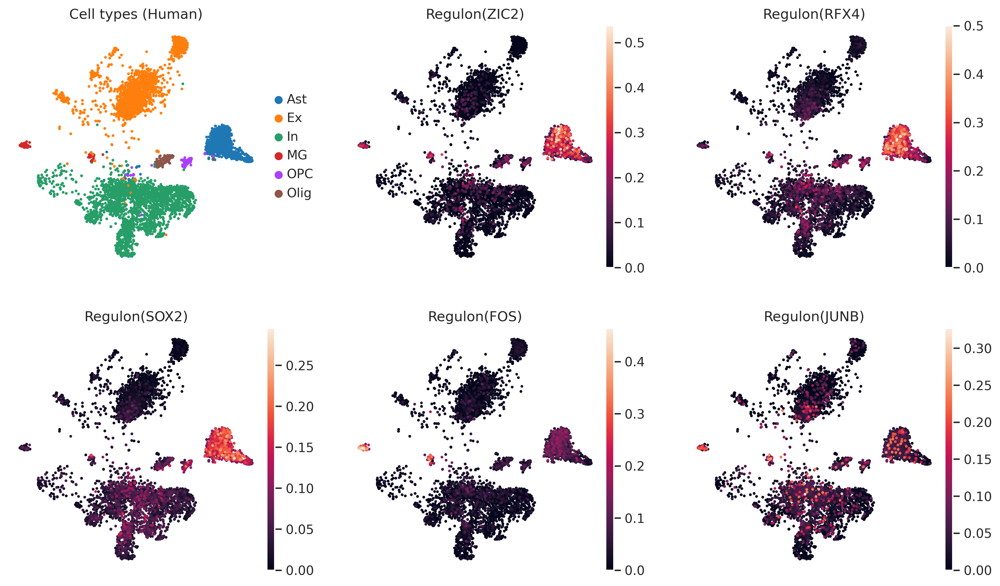

In [70]:
sc.pl.tsne(adata_human, color=['Cell_type', 'Regulon(ZIC2)',
 'Regulon(RFX4)',
 'Regulon(SOX2)',
 'Regulon(FOS)',
 'Regulon(JUNB)'], ncols=3, title = ['Cell types (Human)'])

In [362]:
topreg_human_cell_types

{'Ast': ['ZIC2', 'RFX4', 'SOX2', 'FOS', 'JUNB'],
 'Ex': ['ZNF184', 'ZNF831', 'KLF10', 'CREBZF', 'NR4A3'],
 'In': ['DLX1', 'LHX6', 'ZMAT4', 'SOX4', 'CREBZF'],
 'MG': ['IRF8', 'FOS', 'KLF6', 'ZIC2', 'JUNB'],
 'OPC': ['SOX4', 'SOX2', 'RFX4', 'CREBZF', 'JUNB'],
 'Olig': ['JUNB', 'SOX4', 'RFX4', 'FOS', 'SOX2']}

/home/bavanesyan/miniconda3/envs/pyscenic/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


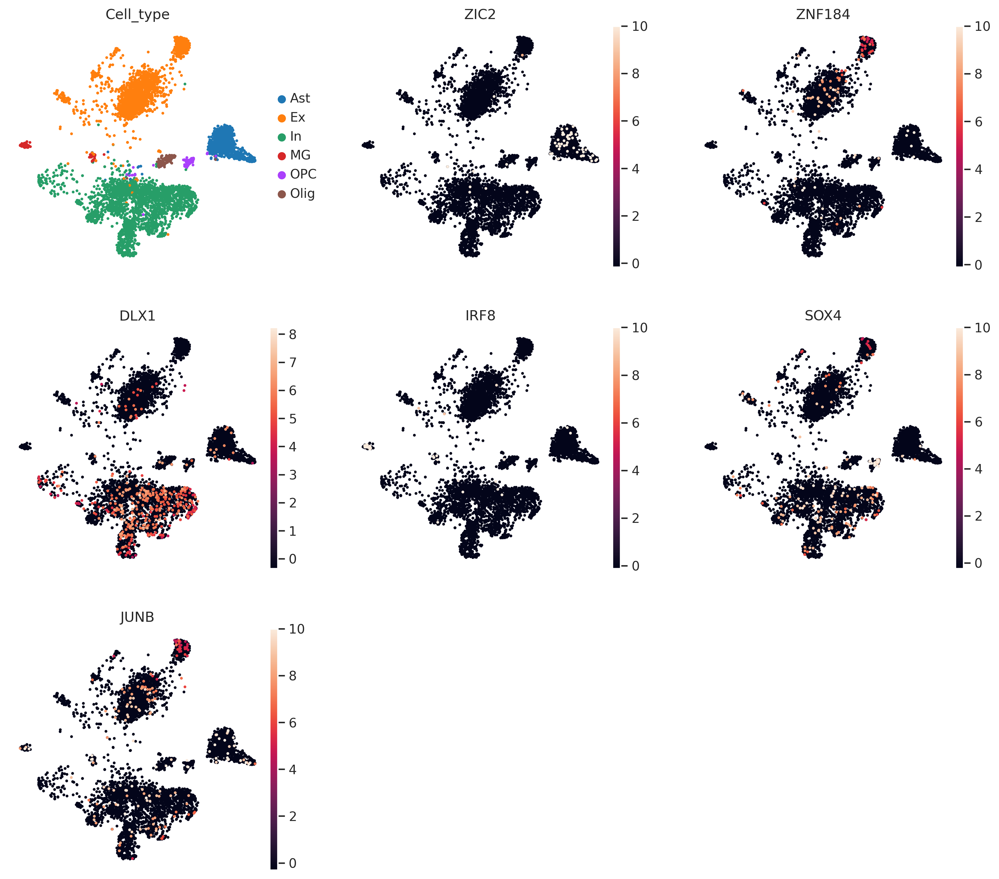

In [363]:
sc.pl.tsne(adata_human, color=['Cell_type', 'ZIC2', 'ZNF184', 'DLX1', 'IRF8', 'SOX4', 'JUNB'], ncols=3)

In [364]:
list(map(lambda x: f'Regulon({x})',['ZIC2', 'ZNF184', 'DLX1', 'IRF8', 'SOX4', 'JUNB']))

['Regulon(ZIC2)',
 'Regulon(ZNF184)',
 'Regulon(DLX1)',
 'Regulon(IRF8)',
 'Regulon(SOX4)',
 'Regulon(JUNB)']

In [366]:
topreg_human_cell_types

{'Ast': ['ZIC2', 'RFX4', 'SOX2', 'FOS', 'JUNB'],
 'Ex': ['ZNF184', 'ZNF831', 'KLF10', 'CREBZF', 'NR4A3'],
 'In': ['DLX1', 'LHX6', 'ZMAT4', 'SOX4', 'CREBZF'],
 'MG': ['IRF8', 'FOS', 'KLF6', 'ZIC2', 'JUNB'],
 'OPC': ['SOX4', 'SOX2', 'RFX4', 'CREBZF', 'JUNB'],
 'Olig': ['JUNB', 'SOX4', 'RFX4', 'FOS', 'SOX2']}

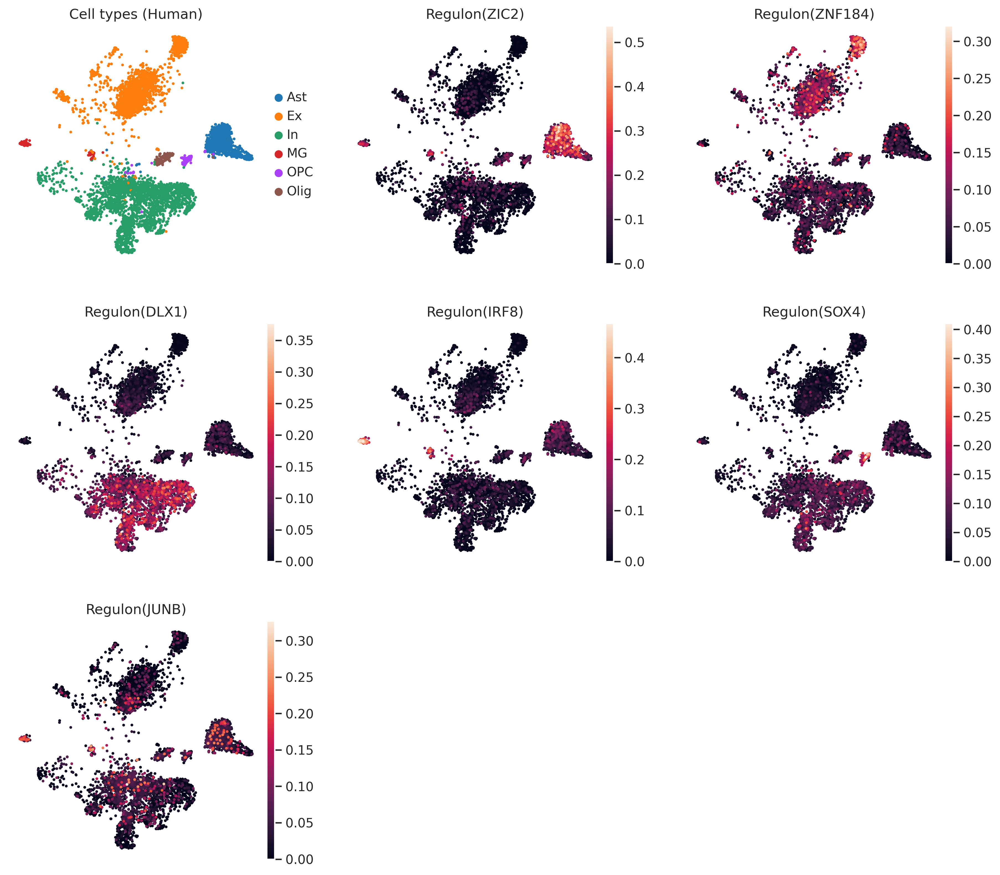

In [71]:
sc.pl.tsne(adata_human, color=['Cell_type', 'Regulon(ZIC2)',
 'Regulon(ZNF184)',
 'Regulon(DLX1)',
 'Regulon(IRF8)',
 'Regulon(SOX4)',
 'Regulon(JUNB)'], ncols=3, title = ['Cell types (Human)'])

In [73]:
topreg_human_cell_types

{'Ast': ['ZIC2', 'RFX4', 'SOX2', 'FOS', 'JUNB'],
 'Ex': ['ZNF184', 'ZNF831', 'KLF10', 'CREBZF', 'NR4A3'],
 'In': ['DLX1', 'LHX6', 'ZMAT4', 'SOX4', 'CREBZF'],
 'MG': ['IRF8', 'FOS', 'KLF6', 'ZIC2', 'JUNB'],
 'OPC': ['SOX4', 'SOX2', 'RFX4', 'CREBZF', 'JUNB'],
 'Olig': ['JUNB', 'SOX4', 'RFX4', 'FOS', 'SOX2']}

In [72]:
topreg_human_louvain

{'0': ['KLF10', 'ZNF184', 'ZNF831', 'NR4A3', 'CREBZF'],
 '1': ['DLX1', 'LHX6', 'ZMAT4', 'SOX4', 'CREBZF'],
 '2': ['ZIC2', 'RFX4', 'SOX2', 'FOS', 'JUNB'],
 '3': ['LHX6', 'ZMAT4', 'DLX1', 'NR4A3', 'CREBZF'],
 '4': ['ZNF184', 'ZNF831', 'SPDEF', 'KLF6', 'NFIC'],
 '5': ['SOX4', 'SOX2', 'JUNB', 'RFX4', 'CREBZF'],
 '6': ['NR4A3', 'ZNF480', 'KLF6', 'NFIC', 'CREBZF'],
 '7': ['IRF8', 'FOS', 'KLF6', 'ZIC2', 'JUNB']}

In [ ]:
['KLF10', 'DLX1', 'ZIC2', 'LHX6', 'ZNF184', 'SOX4', 'NR4A3', 'IRF8']

In [75]:
list(map(lambda x: f'Regulon({x})',['KLF10', 'DLX1', 'ZIC2', 'LHX6', 'ZNF184', 'SOX4', 'NR4A3', 'IRF8']))

['Regulon(KLF10)',
 'Regulon(DLX1)',
 'Regulon(ZIC2)',
 'Regulon(LHX6)',
 'Regulon(ZNF184)',
 'Regulon(SOX4)',
 'Regulon(NR4A3)',
 'Regulon(IRF8)']

/home/bavanesyan/miniconda3/envs/pyscenic/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


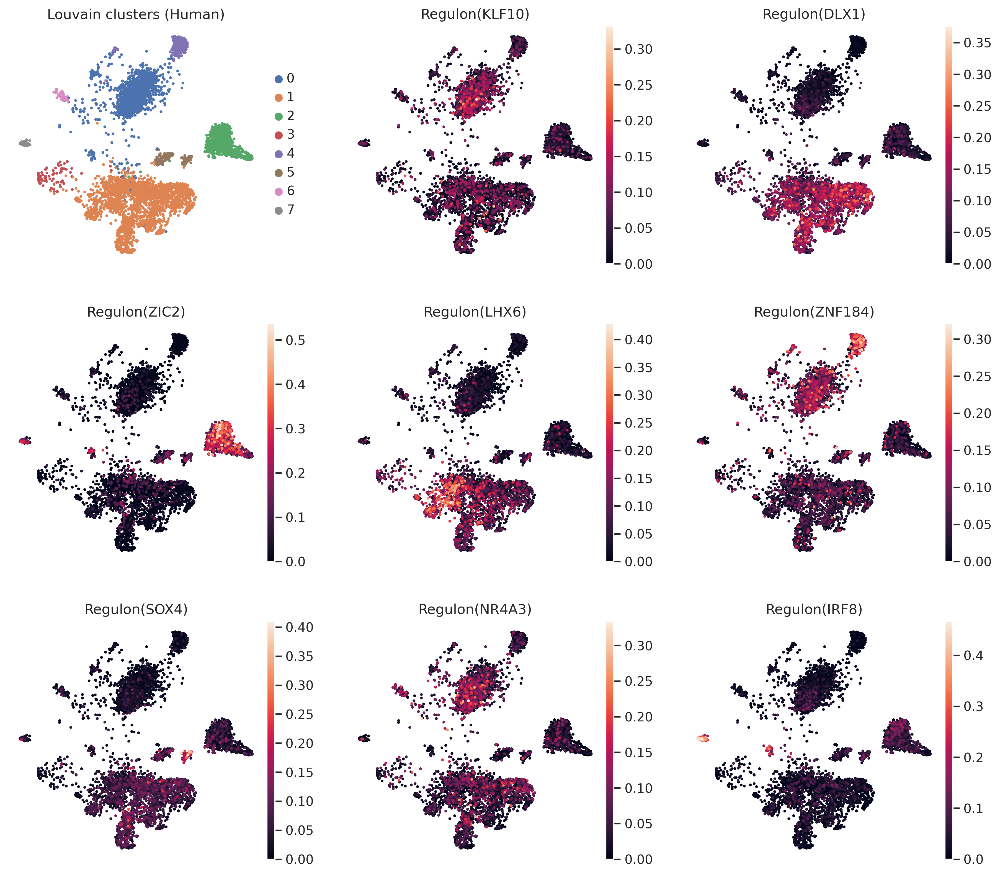

In [76]:
sc.pl.tsne(adata_human, color=['Louvain', 'Regulon(KLF10)',
 'Regulon(DLX1)',
 'Regulon(ZIC2)',
 'Regulon(LHX6)',
 'Regulon(ZNF184)',
 'Regulon(SOX4)',
 'Regulon(NR4A3)',
 'Regulon(IRF8)'], ncols=3, title = ['Louvain clusters (Human)'])

In [90]:
embedding_pca_tsne_human = pd.DataFrame(adata_human.obsm['X_tsne'], columns=[['_X', '_Y']], index=adata_human.obs_names)

In [93]:
adata_human

AnnData object with n_obs × n_vars = 5314 × 1999
    obs: 'Cell_type', 'Species', 'Louvain', 'Regulon(CREBZF)', 'Regulon(DLX1)', 'Regulon(EGR1)', 'Regulon(FOS)', 'Regulon(IRF8)', 'Regulon(JUNB)', 'Regulon(KLF10)', 'Regulon(KLF6)', 'Regulon(LHX6)', 'Regulon(NFIC)', 'Regulon(NR1H2)', 'Regulon(NR4A3)', 'Regulon(RFX4)', 'Regulon(SOX2)', 'Regulon(SOX4)', 'Regulon(SPDEF)', 'Regulon(ZIC2)', 'Regulon(ZMAT4)', 'Regulon(ZNF184)', 'Regulon(ZNF480)', 'Regulon(ZNF831)'
    var: 'Regulon(CREBZF)', 'Regulon(DLX1)', 'Regulon(EGR1)', 'Regulon(FOS)', 'Regulon(IRF8)', 'Regulon(JUNB)', 'Regulon(KLF10)', 'Regulon(KLF6)', 'Regulon(LHX6)', 'Regulon(NFIC)', 'Regulon(NR1H2)', 'Regulon(NR4A3)', 'Regulon(RFX4)', 'Regulon(SOX2)', 'Regulon(SOX4)', 'Regulon(SPDEF)', 'Regulon(ZIC2)', 'Regulon(ZMAT4)', 'Regulon(ZNF184)', 'Regulon(ZNF480)', 'Regulon(ZNF831)'
    uns: 'Cell_type_colors', 'Species_colors', 'aucell', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'rank_genes_groups', 'tsne', 'umap', 'Louvain_colors'
  

In [94]:
sc.tl.tsne(adata_human, use_rep='X_aucell')

computing tSNE
    using sklearn.manifold.TSNE


/home/bavanesyan/miniconda3/envs/pyscenic/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:18)


In [95]:
embedding_aucell_tsne_human = pd.DataFrame(adata_human.obsm['X_tsne'], columns=[['_X', '_Y']], index=adata_human.obs_names)

/home/bavanesyan/miniconda3/envs/pyscenic/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


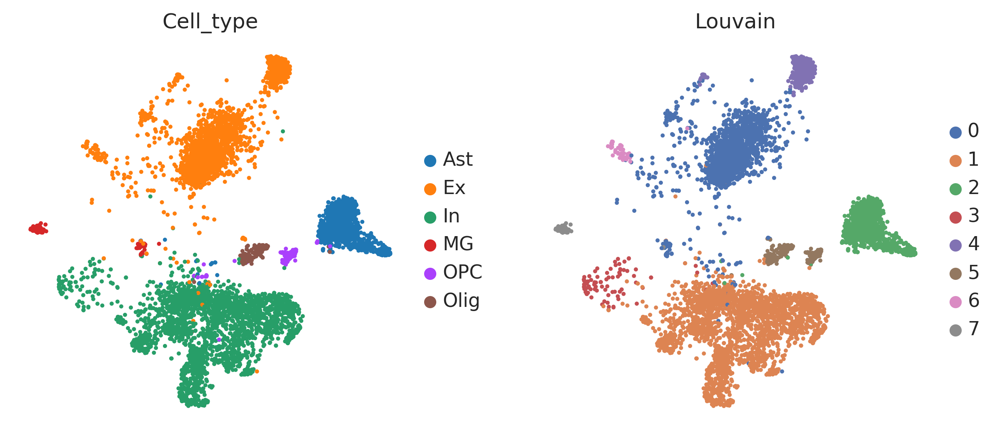

In [104]:
sc.pl.tsne(adata_human, color = ['Cell_type', 'Louvain'])

In [111]:
OrderedDict([('AUCell + tSNE', embedding_aucell_tsne_human), 
                                    ('PCA + tSNE', embedding_pca_tsne_human)])

OrderedDict([('AUCell + tSNE',
                                           _X         _Y
              CellID                                    
              H_AAACGGGAGCCACTAT-1  23.429958   5.184204
              H_AAACGGGCAGTCTTCC-1  26.813765 -20.075100
              H_AAACGGGTCCTATTCA-1   6.456664 -17.350302
              H_AAAGATGGTGTGTGCC-1  70.339371 -10.164708
              H_AAAGCAAGTCGCGGTT-1  74.837425 -24.390312
              ...                         ...        ...
              H_TTTCCTCGTGCTCTTC-5   9.580559  35.826733
              H_TTTGCGCAGGTGATAT-5  27.097395 -96.399475
              H_TTTGGTTTCACCTTAT-5 -44.727627  -7.385207
              H_TTTGTCACACGGTGTC-5 -32.732460  49.465843
              H_TTTGTCACACTGTGTA-5 -12.790027  44.900551
              
              [5314 rows x 2 columns]),
             ('PCA + tSNE',
                                           _X         _Y
              CellID                                    
              H_AAACGGGAGCCACTA

In [114]:
regulons_human_scope = [r.rename(r.name.replace('(',' (')) for r in regulons_human]

In [116]:
export2loom(ex_mtx=adata_human.to_df(), 
            regulons=regulons_human_scope, 
            out_fname='/tank/projects/omics2022/brain_project/pyscenic_res/acc_human/human_scope.loom',
            cell_annotations=adata_human.obs['Cell_type'].to_dict(),
            embeddings=OrderedDict([('AUCell + tSNE', embedding_aucell_tsne_human), 
                                    ('PCA + tSNE', embedding_pca_tsne_human)]),
            auc_mtx = auc_human,
            tree_structure=(),
            title='Human, all cell types',
            nomenclature="HGNC", 
            auc_thresholds=auc_human_thresholds,
            compress=True)

Regulon name does not seem to be compatible with SCOPE. It should include a space to allow selection of the TF. 
Please run: 
 regulons = [r.rename(r.name.replace('(+)',' ('+str(len(r))+'g)')) for r in regulons] 
or:
 regulons = [r.rename(r.name.replace('(',' (')) for r in regulons]


## Macaca

In [54]:
adata_macaca = sc.read('/tank/projects/omics2022/brain_project/pyscenic_res/acc_macaca/macaca_adata_scenic.h5ad')
# aucell_adata_macaca = sc.read('/tank/projects/omics2022/brain_project/pyscenic_res/acc_macaca/macaca_aucell_adata.h5ad')
auc_macaca = pd.read_csv('/tank/projects/omics2022/brain_project/pyscenic_res/acc_macaca/macaca_auc.csv', index_col=0)
rss_macaca_cell_type = calculate_rss(auc_mtx=auc_macaca, adata=adata_macaca, cat_name = 'Cell_type')
rss_macaca_louvain = calculate_rss(auc_mtx=auc_macaca, adata=adata_macaca, cat_name = 'Louvain')
cell_types_macaca = derive_categories(adata=adata_macaca, cat_name='Cell_type')
louvain_cls_macaca = derive_categories(adata=adata_macaca, cat_name='Louvain')
topreg_macaca_cell_types_macaca = derive_topreg(cats=cell_types_macaca, rss = rss_macaca_cell_type, ntops=5)
topreg_macaca_louvain = derive_topreg(cats=louvain_cls_macaca, rss = rss_macaca_louvain, ntops=5)
binary_mtx_macaca, auc_macaca_thresholds = binarize(auc_macaca, num_workers=25)

In [57]:
adata_macaca.obs.Cell_type.value_counts()

Ex      3426
In      1278
Ast       61
Olig      48
MG        22
OPC        8
Name: Cell_type, dtype: int64

In [68]:
adata_macaca.obs.Cell_type.value_counts().apply(lambda x: ((x / adata_macaca.obs.Cell_type.value_counts().sum()) * 100))

Ex      70.741276
In      26.388602
Ast      1.259550
Olig     0.991121
MG       0.454264
OPC      0.165187
Name: Cell_type, dtype: float64

In [58]:
adata_macaca.obs.Louvain.value_counts()

0    3354
1     845
3     395
6      95
2      61
5      55
4      30
7       8
Name: Louvain, dtype: int64

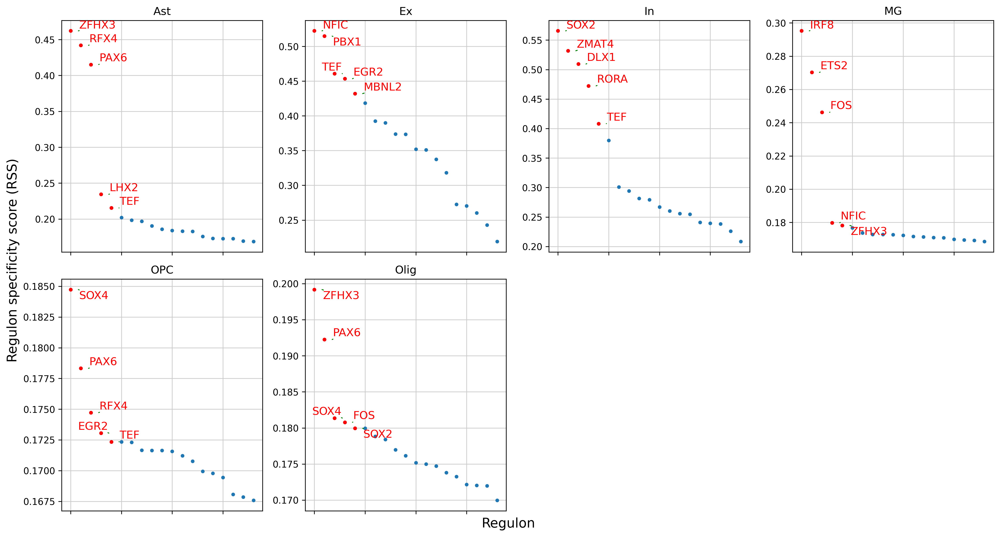

In [31]:
rss_panel_plot(cats=cell_types, rss=rss_macaca_cell_type)

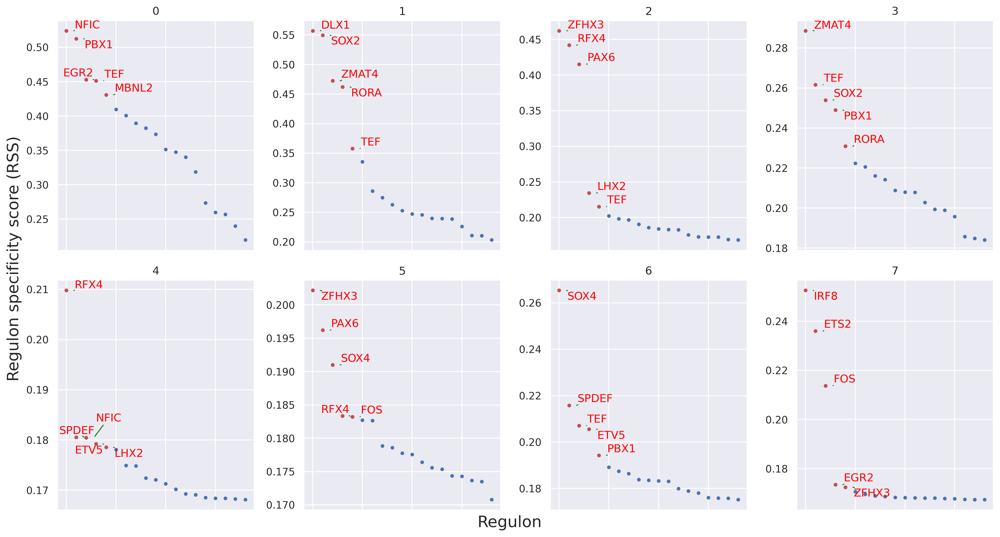

In [37]:
rss_panel_plot(cats=louvain_cls, rss=rss_macaca_louvain)

In [33]:
topreg_macaca_cell_types

{'Ast': ['ZFHX3', 'RFX4', 'PAX6', 'LHX2', 'TEF'],
 'Ex': ['NFIC', 'PBX1', 'TEF', 'EGR2', 'MBNL2'],
 'In': ['SOX2', 'ZMAT4', 'DLX1', 'RORA', 'TEF'],
 'MG': ['IRF8', 'ETS2', 'FOS', 'NFIC', 'ZFHX3'],
 'OPC': ['SOX4', 'PAX6', 'RFX4', 'EGR2', 'TEF'],
 'Olig': ['ZFHX3', 'PAX6', 'SOX4', 'FOS', 'SOX2']}

In [85]:
len(['Regulon(CREBZF)', 'Regulon(DLX1)', 'Regulon(EGR1)', 'Regulon(FOS)', 'Regulon(IRF8)', 'Regulon(JUNB)', 'Regulon(KLF10)', 'Regulon(KLF6)', 'Regulon(LHX6)', 'Regulon(NFIC)', 'Regulon(NR1H2)', 'Regulon(NR4A3)', 'Regulon(RFX4)', 'Regulon(SOX2)', 'Regulon(SOX4)', 'Regulon(SPDEF)', 'Regulon(ZIC2)', 'Regulon(ZMAT4)', 'Regulon(ZNF184)', 'Regulon(ZNF480)', 'Regulon(ZNF831)'
    'Regulon(CREBZF)', 'Regulon(DLX1)', 'Regulon(EGR1)', 'Regulon(FOS)', 'Regulon(IRF8)', 'Regulon(JUNB)', 'Regulon(KLF10)', 'Regulon(KLF6)', 'Regulon(LHX6)', 'Regulon(NFIC)', 'Regulon(NR1H2)', 'Regulon(NR4A3)', 'Regulon(RFX4)', 'Regulon(SOX2)', 'Regulon(SOX4)', 'Regulon(SPDEF)', 'Regulon(ZIC2)', 'Regulon(ZMAT4)', 'Regulon(ZNF184)', 'Regulon(ZNF480)', 'Regulon(ZNF831)'])

41

In [86]:
auc_human

,CREBZF,DLX1,EGR1,FOS,IRF8,JUNB,KLF10,KLF6,LHX6,NFIC,...,NR4A3,RFX4,SOX2,SOX4,SPDEF,ZIC2,ZMAT4,ZNF184,ZNF480,ZNF831
Cell,,,,,,,,,,,,,,,,,,,,,
H_AAACGGGAGCCACTAT-1,0.153017,0.009194,0.000000,0.000564,0.022895,0.000000,0.028103,0.056626,0.003995,0.094922,...,0.050406,0.028485,0.000000,0.003505,0.000000,0.000000,0.068074,0.003715,0.000000,0.031927
H_AAACGGGCAGTCTTCC-1,0.044542,0.019243,0.000000,0.002575,0.075056,0.034106,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.025436,0.021916,0.000000,0.059306,0.000000,0.035427,0.000000,0.000000
H_AAACGGGTCCTATTCA-1,0.018698,0.059068,0.000000,0.000000,0.006345,0.000000,0.041339,0.000000,0.000000,0.013822,...,0.000000,0.000000,0.002579,0.016222,0.009249,0.000000,0.034125,0.000000,0.036389,0.000000
H_AAAGATGGTGTGTGCC-1,0.058125,0.000000,0.000000,0.000000,0.000000,0.000000,0.025652,0.017156,0.000000,0.105328,...,0.025176,0.003030,0.000000,0.000000,0.144212,0.004562,0.000409,0.075488,0.000000,0.089654
H_AAAGCAAGTCGCGGTT-1,0.000000,0.113407,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.078430,0.000000,...,0.000000,0.000000,0.013813,0.015693,0.174719,0.000476,0.015556,0.049640,0.067629,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
H_TTTCCTCGTGCTCTTC-5,0.045642,0.000000,0.000000,0.000000,0.000000,0.055197,0.051482,0.000000,0.000000,0.000000,...,0.000000,0.125656,0.027618,0.000000,0.004270,0.000000,0.007656,0.113408,0.000000,0.000000
H_TTTGCGCAGGTGATAT-5,0.100173,0.000000,0.509904,0.046672,0.009534,0.022345,0.053499,0.000000,0.004429,0.018624,...,0.177890,0.162109,0.021756,0.000000,0.006495,0.000000,0.037508,0.045589,0.000000,0.048889
H_TTTGGTTTCACCTTAT-5,0.040837,0.122249,0.000000,0.000000,0.080479,0.046196,0.022859,0.000000,0.048940,0.000000,...,0.077842,0.060719,0.037094,0.026330,0.046243,0.000000,0.107230,0.078478,0.000000,0.000000


In [83]:
adata_human

AnnData object with n_obs × n_vars = 5314 × 1999
    obs: 'Cell_type', 'Species', 'Louvain', 'Regulon(CREBZF)', 'Regulon(DLX1)', 'Regulon(EGR1)', 'Regulon(FOS)', 'Regulon(IRF8)', 'Regulon(JUNB)', 'Regulon(KLF10)', 'Regulon(KLF6)', 'Regulon(LHX6)', 'Regulon(NFIC)', 'Regulon(NR1H2)', 'Regulon(NR4A3)', 'Regulon(RFX4)', 'Regulon(SOX2)', 'Regulon(SOX4)', 'Regulon(SPDEF)', 'Regulon(ZIC2)', 'Regulon(ZMAT4)', 'Regulon(ZNF184)', 'Regulon(ZNF480)', 'Regulon(ZNF831)'
    var: 'Regulon(CREBZF)', 'Regulon(DLX1)', 'Regulon(EGR1)', 'Regulon(FOS)', 'Regulon(IRF8)', 'Regulon(JUNB)', 'Regulon(KLF10)', 'Regulon(KLF6)', 'Regulon(LHX6)', 'Regulon(NFIC)', 'Regulon(NR1H2)', 'Regulon(NR4A3)', 'Regulon(RFX4)', 'Regulon(SOX2)', 'Regulon(SOX4)', 'Regulon(SPDEF)', 'Regulon(ZIC2)', 'Regulon(ZMAT4)', 'Regulon(ZNF184)', 'Regulon(ZNF480)', 'Regulon(ZNF831)'
    uns: 'Cell_type_colors', 'Species_colors', 'aucell', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'rank_genes_groups', 'tsne', 'umap', 'Louvain_colors'
  

In [39]:
topreg_macaca_cell_types

{'Ast': ['ZFHX3', 'RFX4', 'PAX6', 'LHX2', 'TEF'],
 'Ex': ['NFIC', 'PBX1', 'TEF', 'EGR2', 'MBNL2'],
 'In': ['SOX2', 'ZMAT4', 'DLX1', 'RORA', 'TEF'],
 'MG': ['IRF8', 'ETS2', 'FOS', 'NFIC', 'ZFHX3'],
 'OPC': ['SOX4', 'PAX6', 'RFX4', 'EGR2', 'TEF'],
 'Olig': ['ZFHX3', 'PAX6', 'SOX4', 'FOS', 'SOX2']}

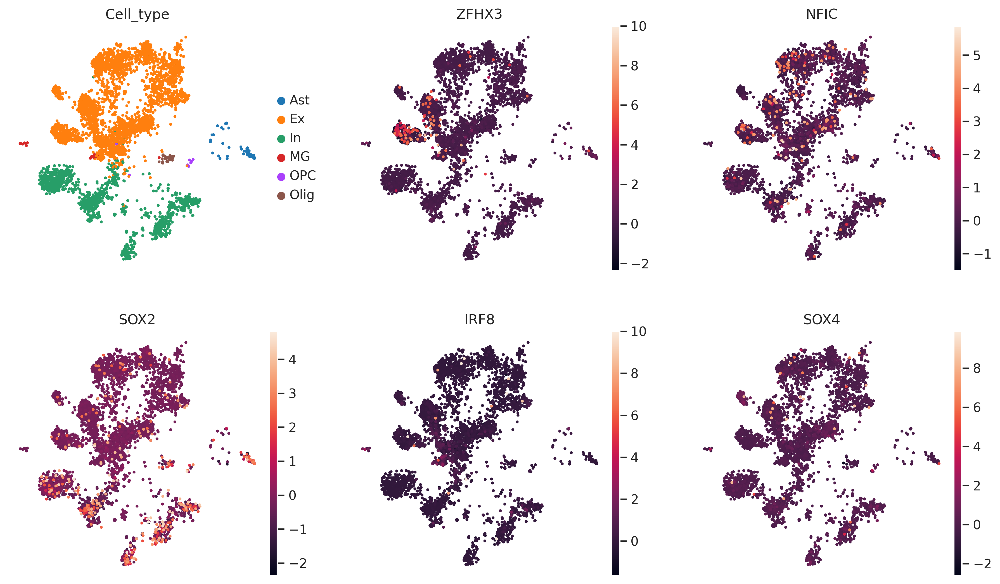

In [44]:
sc.pl.tsne(adata_macaca, color=['Cell_type', 'ZFHX3', 'NFIC', 'SOX2', 'IRF8', 'SOX4'], ncols=3)

In [42]:
list(map(lambda x: f'Regulon({x})', ['ZFHX3', 'NFIC', 'SOX2', 'IRF8', 'SOX4', 'ZFHX3']))

['Regulon(ZFHX3)',
 'Regulon(NFIC)',
 'Regulon(SOX2)',
 'Regulon(IRF8)',
 'Regulon(SOX4)',
 'Regulon(ZFHX3)']

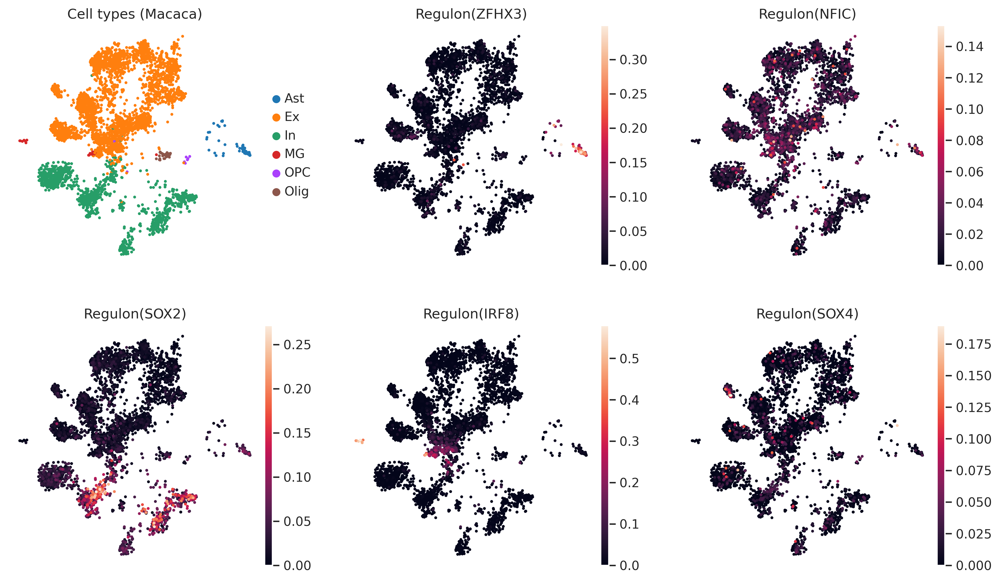

In [79]:
sc.pl.tsne(adata_macaca, color=['Cell_type', 'Regulon(ZFHX3)',
 'Regulon(NFIC)',
 'Regulon(SOX2)',
 'Regulon(IRF8)',
 'Regulon(SOX4)',], ncols=3, title = ['Cell types (Macaca)'])

In [46]:
topreg_macaca_louvain

{'0': ['NFIC', 'PBX1', 'EGR2', 'TEF', 'MBNL2'],
 '1': ['DLX1', 'SOX2', 'ZMAT4', 'RORA', 'TEF'],
 '2': ['ZFHX3', 'RFX4', 'PAX6', 'LHX2', 'TEF'],
 '3': ['ZMAT4', 'TEF', 'SOX2', 'PBX1', 'RORA'],
 '4': ['RFX4', 'SPDEF', 'NFIC', 'ETV5', 'LHX2'],
 '5': ['ZFHX3', 'PAX6', 'SOX4', 'RFX4', 'FOS'],
 '6': ['SOX4', 'SPDEF', 'TEF', 'ETV5', 'PBX1'],
 '7': ['IRF8', 'ETS2', 'FOS', 'EGR2', 'ZFHX3']}

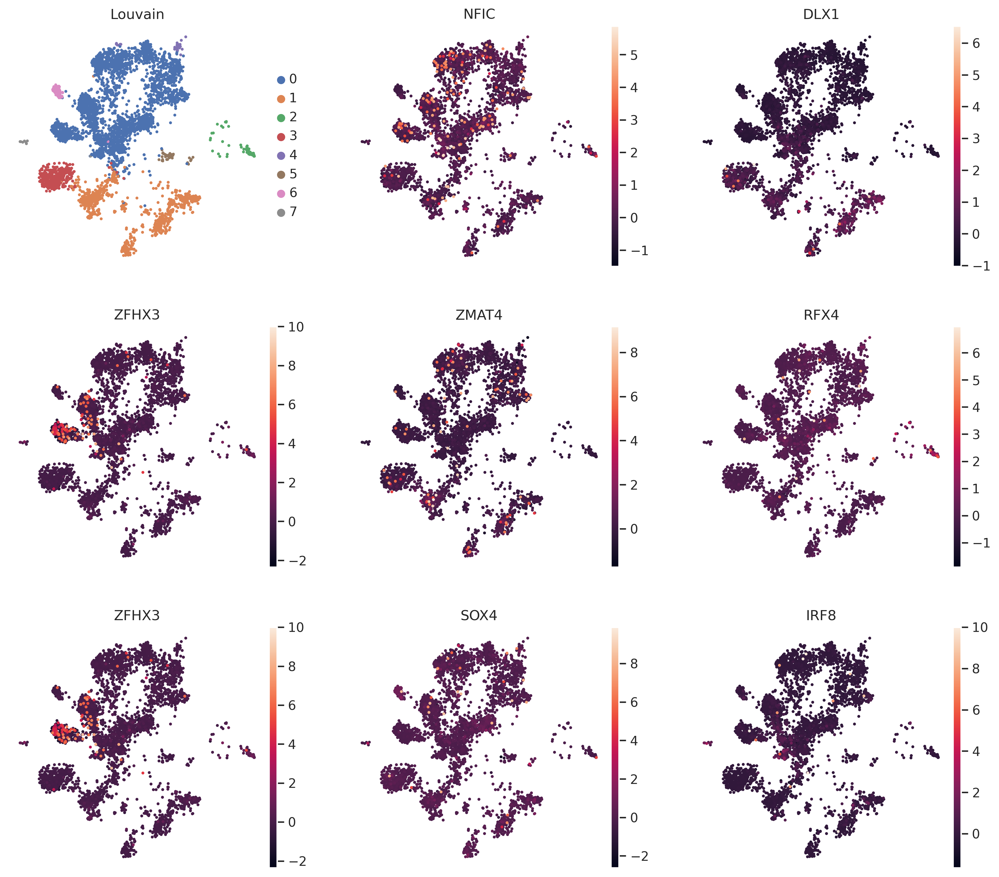

In [48]:
sc.pl.tsne(adata_macaca, color=['Louvain', 'NFIC', 'DLX1', 'ZFHX3', 'ZMAT4', 'RFX4', 'ZFHX3', 'SOX4', 'IRF8'], ncols=3)

In [49]:
list(map(lambda x: f'Regulon({x})', ['NFIC', 'DLX1', 'ZFHX3', 'ZMAT4', 'RFX4', 'ZFHX3', 'SOX4', 'IRF8']))

['Regulon(NFIC)',
 'Regulon(DLX1)',
 'Regulon(ZFHX3)',
 'Regulon(ZMAT4)',
 'Regulon(RFX4)',
 'Regulon(ZFHX3)',
 'Regulon(SOX4)',
 'Regulon(IRF8)']

/home/bavanesyan/miniconda3/envs/pyscenic/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


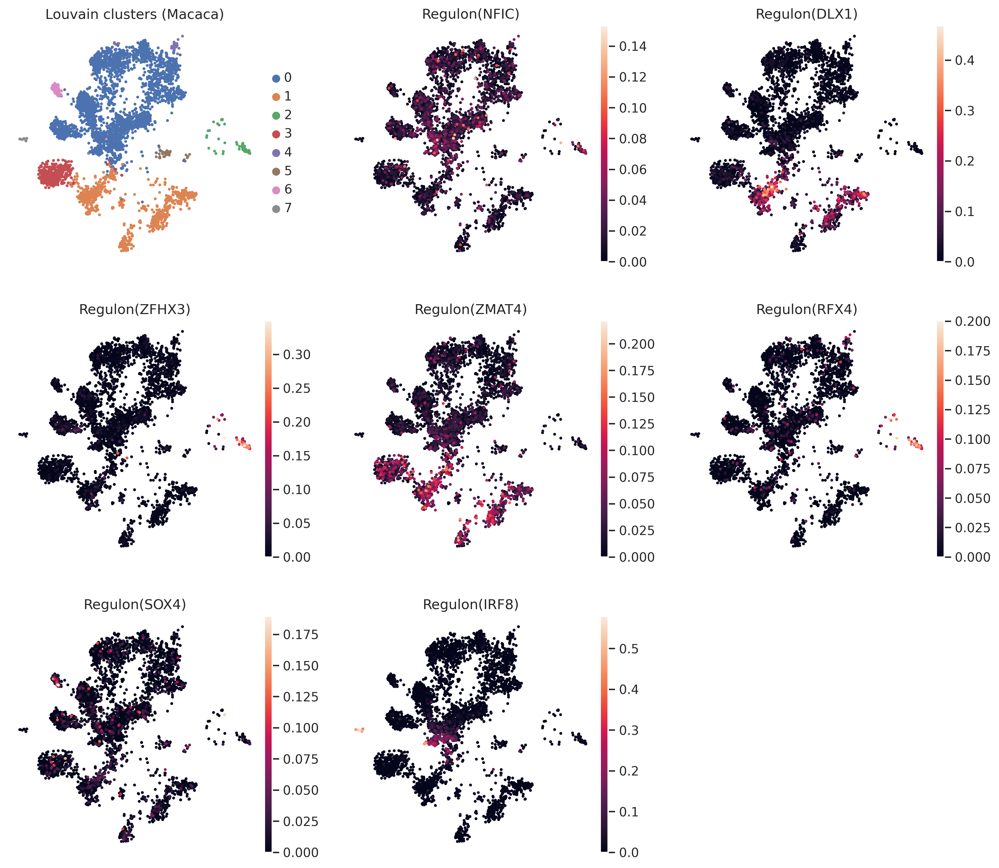

In [80]:
sc.pl.tsne(adata_macaca, color=['Louvain', 'Regulon(NFIC)',
 'Regulon(DLX1)',
 'Regulon(ZFHX3)',
 'Regulon(ZMAT4)',
 'Regulon(RFX4)',
 'Regulon(SOX4)',
 'Regulon(IRF8)'], ncols=3, title=['Louvain clusters (Macaca)'])